<a href="https://colab.research.google.com/github/djbrady/CNNprocessing/blob/main/pytchographicArrayImaging.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Issues related to phase retrieval and ptychographic imaging
## David Brady
## University of Arizona
## February 2021

This notebook seeks to organize thoughts on ptychographic imaging. At first the notebook will consist of random thoughts and challenges, such as models of the imaging process, consideration of aperture size, coherence considerations, etc. 


## initialization

In [11]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import skimage
import os
from matplotlib import animation, rc
from skimage import io
from skimage import transform
from skimage import filters
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.datasets import mnist
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]


In [2]:
from google.colab import drive

drive.mount('gdrive')

Mounted at gdrive


# 1D problem definition

Ptychography consists of estimation of a signal $f(x)$ from measurements of the squared magnitude of time-frequency represention, $g(x,u)$, where 
$$
g(x,u)=\left |\int f(x') e^{i2\pi x'u} h(x-x') dx'\right |^2
$$
Interesting issues in considering this problem include the sampling rate in the $x,u$ plane and coding strategy in the selection of $h(x)$. To begin consideration of these issues, we might assume that $f(x)$ is represented by a sampling function $\psi(x)$ such that $f(x)=\sum_n f_n \psi(x-n\Delta)$, which allows us to express $g(x)$ as
$$
g(x,u)= |{\mathbf h}(x,u) \cdot {\mathbf f}|^2
$$
where
$$
h_n(x,u)=\left |\int \psi(x'-n\Delta ) e^{i2\pi x'u} h(x-x') dx'\right |^2
$$

To understand the utility of this coding, it is helpful to consider the cases 
$$f(x)=\delta (x-x_o),$$
which yields
$$
g(x,u)=|h(x-x_o) |^2
$$
and $$f(x)=\delta (x-\frac{\Delta}{2})+\delta (x+\frac{\Delta}{2}),$$
which yields
$$
g(x,u)=4|h(x)|^2\cos^2 \left (\pi u \Delta \right )
$$
where where we assume that $\Delta $ is sufficiently small that $h(x+\Delta)=h(x)$. We see that by measuring the frequency on the $u$ axis we can determine $\Delta $ even though the two points are unresolved by the impulse response. Rather than the width of the impulse response, the minimum resolvable distance between point sources would now be 

Ptychography is thus a multiplex measurement strategy using local interference in the focal plane to enable subdiffraction limited resolution. 

In practice, the illumination source has some finite spectral bandwidth, which scales both $u$ and $h()$ as a function of frequency. In this case
$$
g(x,u)=\int S(\nu) \left |\int f(x') e^{i2\pi \frac{\nu}{\bar \nu} x'u} h\left (\frac{\nu}{\nu_o}(x-x')\right ) dx'\right |^2d\nu
$$
The net effect of finite bandwith is to blur the fringes that enable aliasing and analysis, decreasing constrast and SNR. In the above example of two point sources, if $S(\nu)=1$ over the frequencies $\delta \nu$, the observed intensity is 
$$
g(x,u)=2|h(x)|^2 \left \lbrack 1+\frac{\nu_o}{2\pi u\Delta\delta\nu}\sin\left (\pi\frac{\delta\nu}{\nu_o}u\Delta\right )\cos \left (2\pi u \Delta \right ) \right \rbrack
$$
or 
$$
g(x,u)=2|h(x)|^2 \left \lbrack 1+{\rm sinc}\left (2\frac{\delta\nu}{\nu_o}u\Delta\right )\cos \left (2\pi u \Delta \right ) \right \rbrack
$$
Thus, the effect of finite bandwidth is to decrease the fringe visibility and to introduce harmonics which will blur the fringes. 

The number of fringes observed between the two point sources is a measure of the space-bandwidth product within a resolution cell. For example, if we want to observe 10 points we might assume that the maximium of $u\Delta$ is 10. Requiring that this occur within the central lobe of the sinc, we would require that 
$$\frac{\delta \nu}{\nu}u\Delta<1$$
such that the fractional bandwidth must be less than the space bandwidth product increase. 

# Imaging system example

We consider a model imaging system. Consider first the field assume that the field is illuminated by a coherent source but that the scattering is incoherent. In this case, the cross spectral density of the remotely observed field is 
$$
W(\Delta X, \Delta Y) 
$$

## tests on April 7

here we look at the test images illuminated by red led.

In [ ]:
!ls /content/gdrive/MyDrive/Research/arrayCameraPtychography/barcodeTest2/red

frame-0.png  frame-1.png  frame-2.png  frame-3.png  frame-4.png


In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/barcodeTest2/red/frame-1.png')

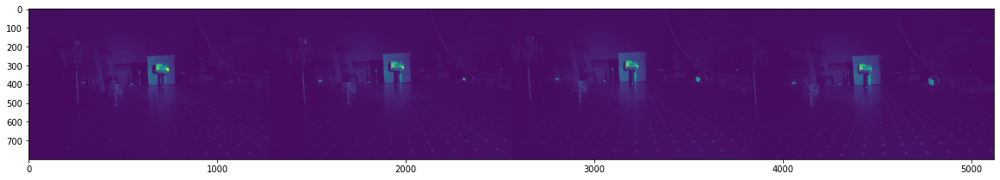

In [ ]:
plt.imshow(pip0)

In [ ]:
pip2.shape

(800, 5120)

In [ ]:
5120/4

1280.0

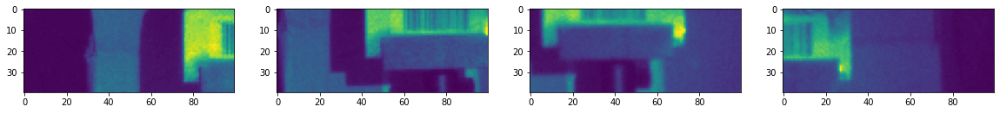

In [ ]:
for pip in range(4):
  plt.subplot(1,4,pip+1)
  plt.imshow(pip0[300:340,(600+pip*1280):(700+pip*1280)])


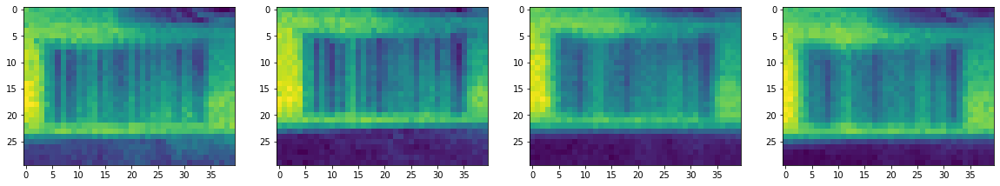

In [ ]:
fred=plt.figure(1)
plt.subplot(1,4,1)
plt.imshow(pip0[300:330,690:730])
plt.subplot(1,4,2)
plt.imshow(pip0[290:320,(655+1280):(695+1280)])
plt.subplot(1,4,3)
plt.imshow(pip0[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip0[300:330,(580+3*1280):(620+3*1280)])

In [ ]:
pip1=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/barcodeTest2/violet/frame-3.png')

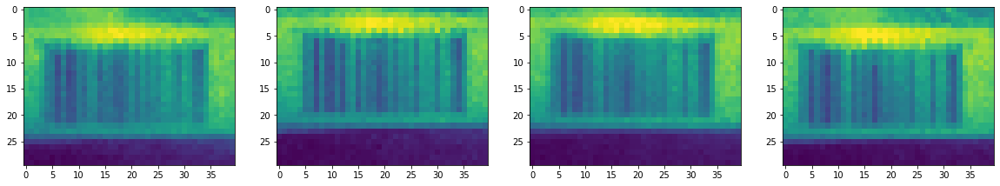

In [ ]:
fviolet=plt.figure(2)
plt.subplot(1,4,1)
plt.imshow(pip1[300:330,690:730])
plt.subplot(1,4,2)
plt.imshow(pip1[290:320,(655+1280):(695+1280)])
plt.subplot(1,4,3)
plt.imshow(pip1[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip1[300:330,(580+3*1280):(620+3*1280)])



In [ ]:
pip2=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/barcodeTest2/white/frame-3.png')

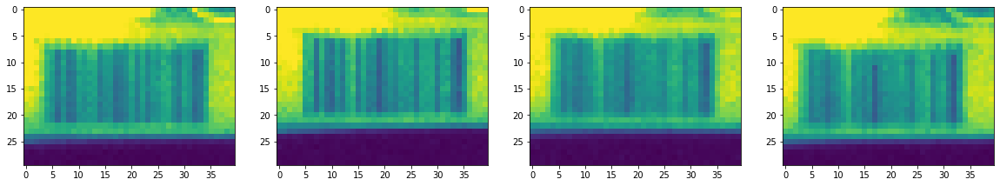

In [ ]:
fwhite=plt.figure(3)
plt.subplot(1,4,1)
plt.imshow(pip2[300:330,690:730])
plt.subplot(1,4,2)
plt.imshow(pip2[290:320,(655+1280):(695+1280)])
plt.subplot(1,4,3)
plt.imshow(pip2[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip2[300:330,(580+3*1280):(620+3*1280)])

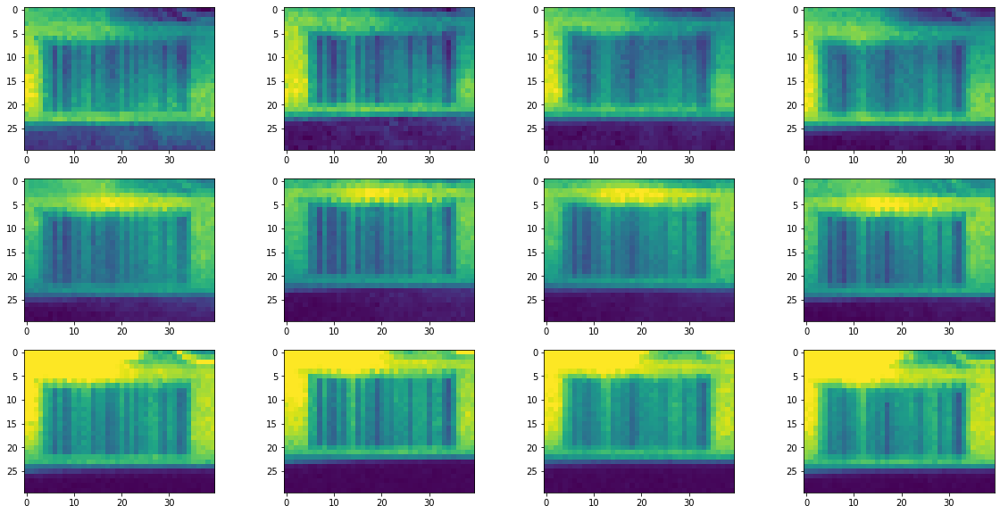

In [ ]:
#red images
plt.subplot(3,4,1)
plt.imshow(pip0[300:330,690:730])
plt.subplot(3,4,2)
plt.imshow(pip0[290:320,(655+1280):(695+1280)])
plt.subplot(3,4,3)
plt.imshow(pip0[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(3,4,4)
plt.imshow(pip0[300:330,(580+3*1280):(620+3*1280)])
#violet images
plt.subplot(3,4,5)
plt.imshow(pip1[300:330,690:730])
plt.subplot(3,4,6)
plt.imshow(pip1[290:320,(655+1280):(695+1280)])
plt.subplot(3,4,7)
plt.imshow(pip1[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(3,4,8)
plt.imshow(pip1[300:330,(580+3*1280):(620+3*1280)])
#white image
plt.subplot(3,4,9)
plt.imshow(pip2[300:330,690:730])
plt.subplot(3,4,10)
plt.imshow(pip2[290:320,(655+1280):(695+1280)])
plt.subplot(3,4,11)
plt.imshow(pip2[285:315,(620+2*1280):(660+2*1280)])
plt.subplot(3,4,12)
plt.imshow(pip2[300:330,(580+3*1280):(620+3*1280)])


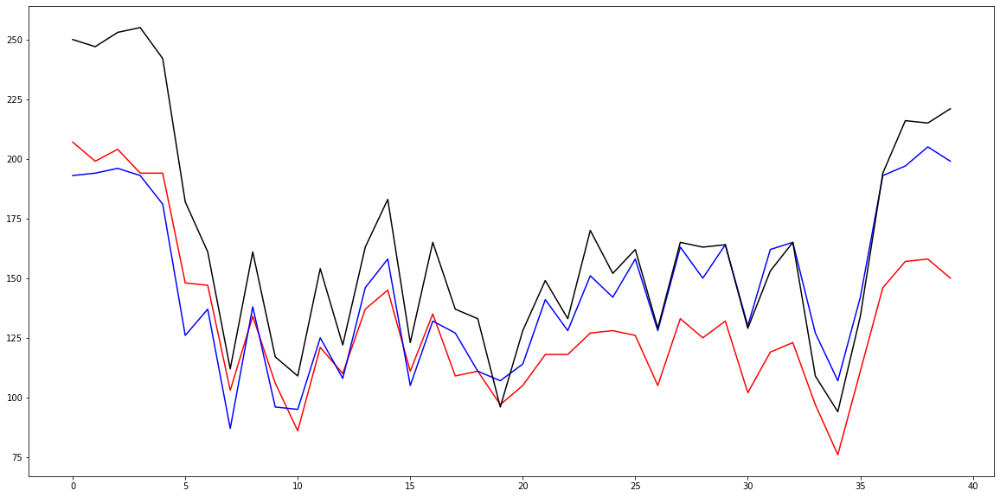

In [ ]:
plt.plot(range(40),pip0[300,(655+1280):(695+1280)],'r',range(40),pip1[300,(655+1280):(695+1280)],'b',range(40),pip2[300,(655+1280):(695+1280)],'k')

## tests on April 8

here we look at the test images illuminated by red, violet, incandescent and flourescent sources.

In [ ]:
!ls /content/gdrive/MyDrive/Research/arrayCameraPtychography/testData/500mm/

lamp  red  violet  white


In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/500mm/red/frame-1.png')

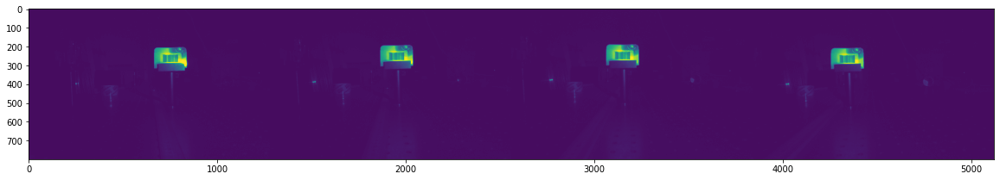

In [ ]:
plt.imshow(pip0)

In [ ]:
pip2.shape

(800, 5120)

In [ ]:
5120/4

1280.0

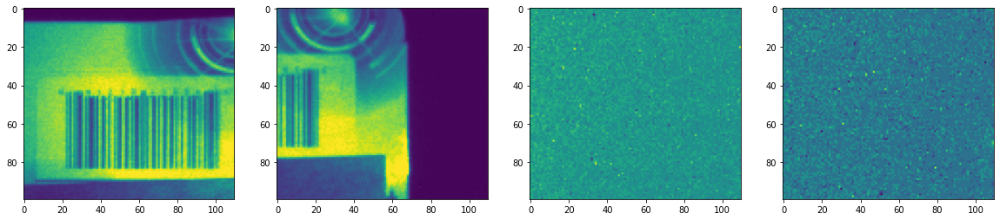

In [ ]:
for pip in range(4):
  plt.subplot(1,4,pip+1)
  plt.imshow(pip0[200:300,(690+pip*1280):(800+pip*1280)])


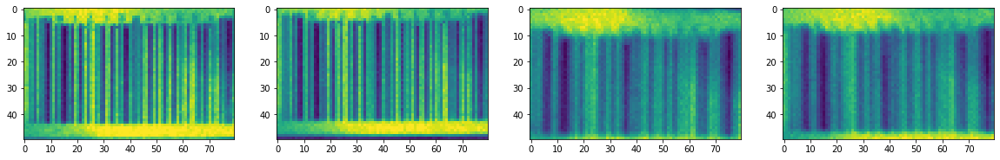

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[240:290,710:790])
plt.subplot(1,4,2)
plt.imshow(pip0[230:280,(630+1280):(710+1280)])
plt.subplot(1,4,3)
plt.imshow(pip0[220:270,(550+2*1280):(630+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip0[240:290,(460+3*1280):(540+3*1280)])

In [ ]:
pip1=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/500mm/violet/frame-1.png')

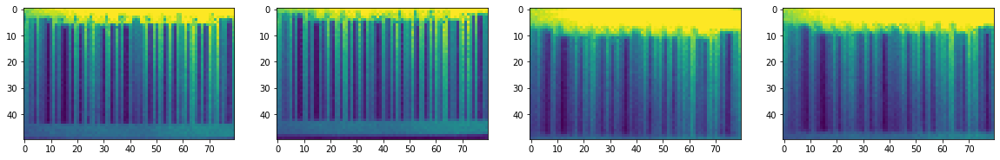

In [ ]:

plt.subplot(1,4,1)
plt.imshow(pip1[240:290,710:790])
plt.subplot(1,4,2)
plt.imshow(pip1[230:280,(630+1280):(710+1280)])
plt.subplot(1,4,3)
plt.imshow(pip1[220:270,(550+2*1280):(630+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip1[240:290,(460+3*1280):(540+3*1280)])



In [ ]:
pip2=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/500mm/white/frame-1.png')

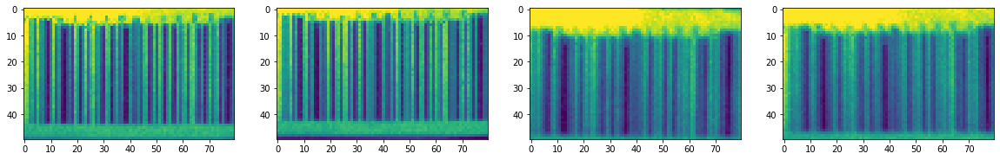

In [ ]:

plt.subplot(1,4,1)
plt.imshow(pip2[240:290,710:790])
plt.subplot(1,4,2)
plt.imshow(pip2[230:280,(630+1280):(710+1280)])
plt.subplot(1,4,3)
plt.imshow(pip2[220:270,(550+2*1280):(630+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip2[240:290,(460+3*1280):(540+3*1280)])


In [ ]:
pip3=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/500mm/lamp/frame-1.png')

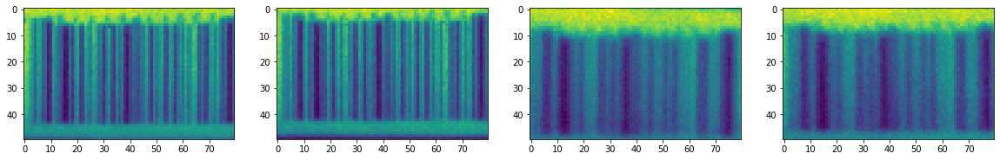

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip3[240:290,710:790])
plt.subplot(1,4,2)
plt.imshow(pip3[230:280,(630+1280):(710+1280)])
plt.subplot(1,4,3)
plt.imshow(pip3[220:270,(550+2*1280):(630+2*1280)])
plt.subplot(1,4,4)
plt.imshow(pip3[240:290,(460+3*1280):(540+3*1280)])


In [ ]:
def g(dnu):
  u=np.linspace(-10.,10.,200)
  g=1+np.sinc(2*dnu*u)*np.cos(2*np.pi*u)
  return g


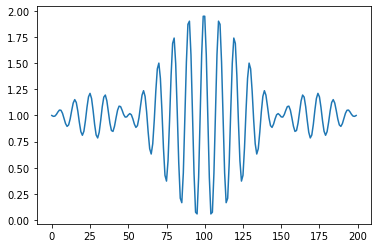

In [ ]:
plt.plot(g(.1))

## more work on april 8 data

In [ ]:
!ls /content/gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode

1000mm	1500mm	2000mm	2500mm	3000mm	500mm


### 2500 m

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/2500mm/red/frame-1.png')

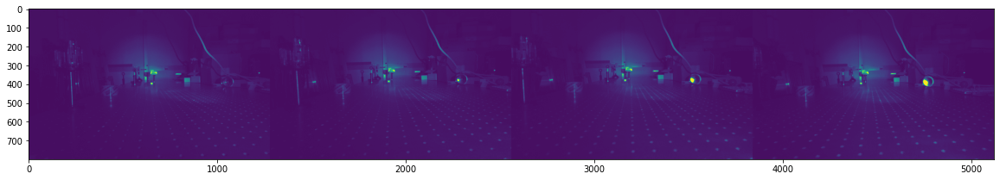

In [ ]:
plt.imshow(pip0)

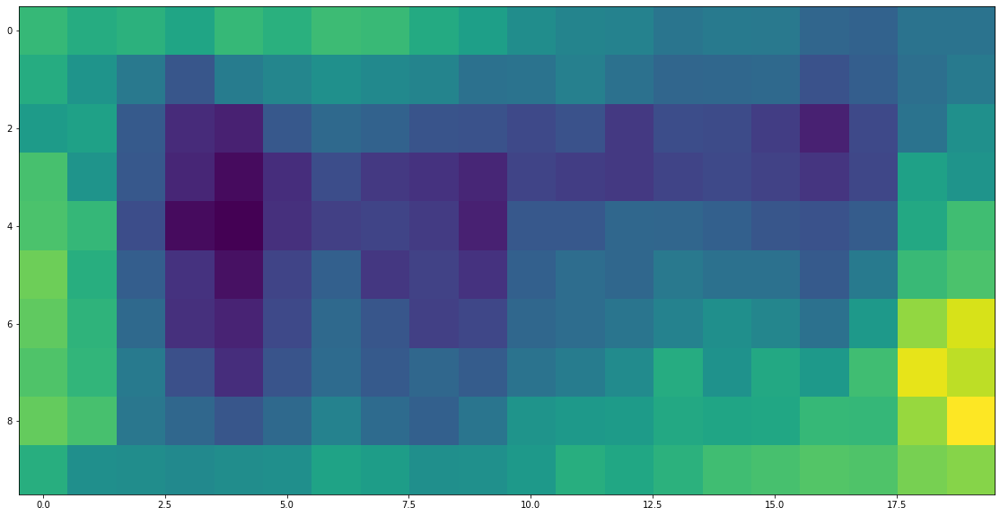

In [ ]:
plt.imshow(pip0[331:341,4427:4447])

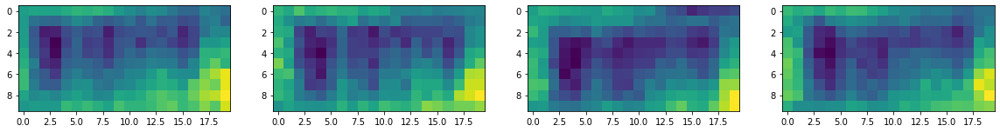

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[332:342,655:675])
plt.subplot(1,4,2)
plt.imshow(pip0[320:330,1915:1935])
plt.subplot(1,4,3)
plt.imshow(pip0[314:324,3173:3193])
plt.subplot(1,4,4)
plt.imshow(pip0[331:341,4427:4447])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/2500mm/violet/frame-1.png')

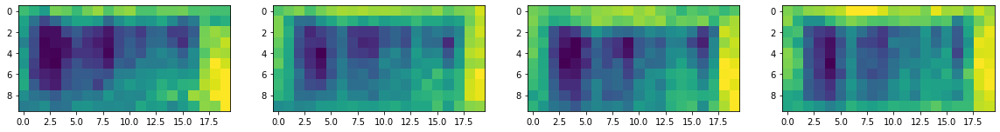

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[332:342,655:675])
plt.subplot(1,4,2)
plt.imshow(pip0[320:330,1915:1935])
plt.subplot(1,4,3)
plt.imshow(pip0[314:324,3173:3193])
plt.subplot(1,4,4)
plt.imshow(pip0[331:341,4427:4447])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/2500mm/white/frame-1.png')

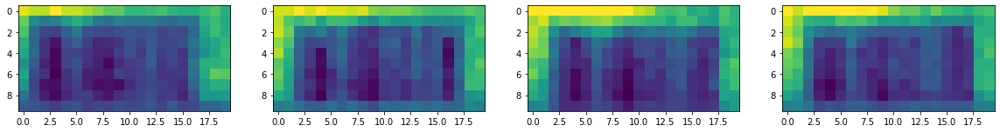

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[332:342,655:675])
plt.subplot(1,4,2)
plt.imshow(pip0[320:330,1915:1935])
plt.subplot(1,4,3)
plt.imshow(pip0[314:324,3173:3193])
plt.subplot(1,4,4)
plt.imshow(pip0[331:341,4427:4447])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/2500mm/lamp/frame-1.png')

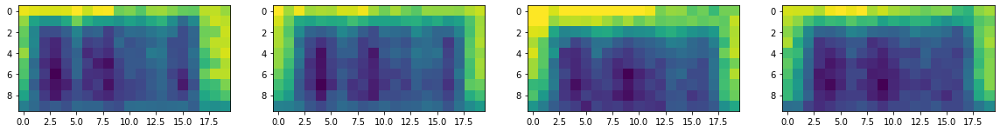

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[332:342,655:675])
plt.subplot(1,4,2)
plt.imshow(pip0[320:330,1915:1935])
plt.subplot(1,4,3)
plt.imshow(pip0[314:324,3173:3193])
plt.subplot(1,4,4)
plt.imshow(pip0[331:341,4427:4447])

### 1500 m

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/1500mm/red/frame-1.png')

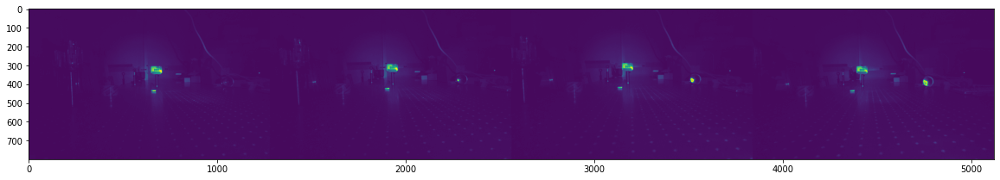

In [ ]:
plt.imshow(pip0)

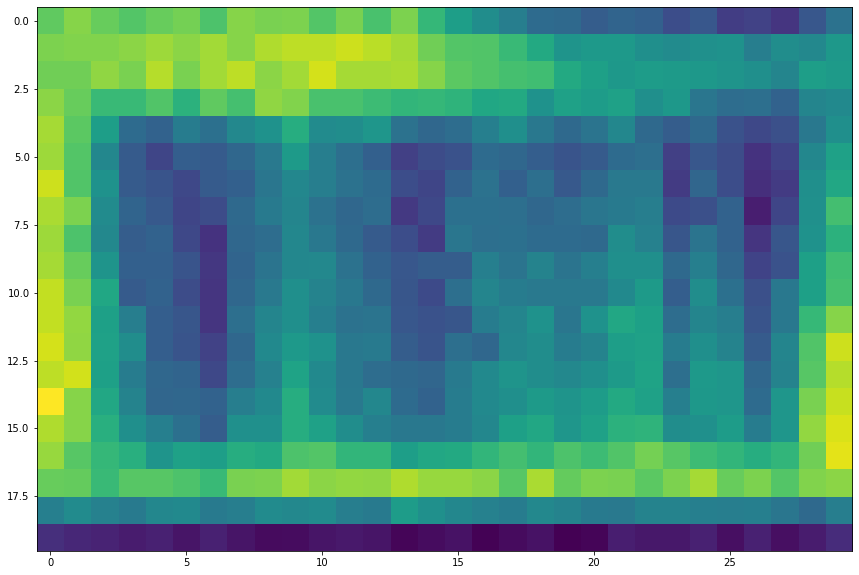

In [ ]:
plt.imshow(pip0[315:335,4405:4435])

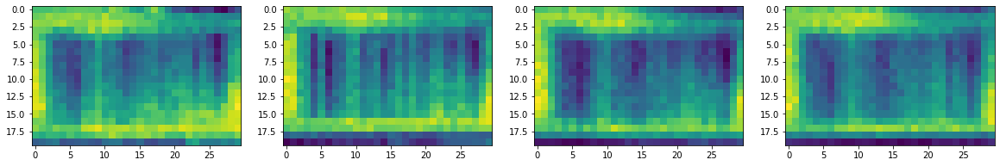

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[315:335,663:693])
plt.subplot(1,4,2)
plt.imshow(pip0[304:324,1913:1943])
plt.subplot(1,4,3)
plt.imshow(pip0[298:318,3161:3191])
plt.subplot(1,4,4)
plt.imshow(pip0[315:335,4405:4435])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/1500mm/violet/frame-1.png')

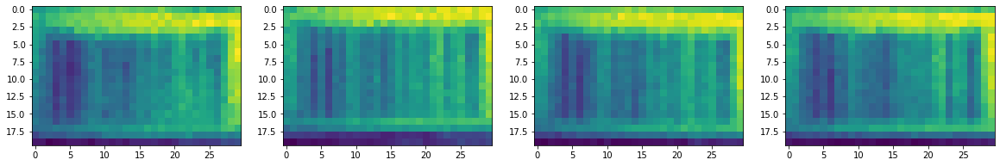

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[315:335,663:693])
plt.subplot(1,4,2)
plt.imshow(pip0[304:324,1913:1943])
plt.subplot(1,4,3)
plt.imshow(pip0[298:318,3161:3191])
plt.subplot(1,4,4)
plt.imshow(pip0[315:335,4405:4435])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/1500mm/white/frame-1.png')

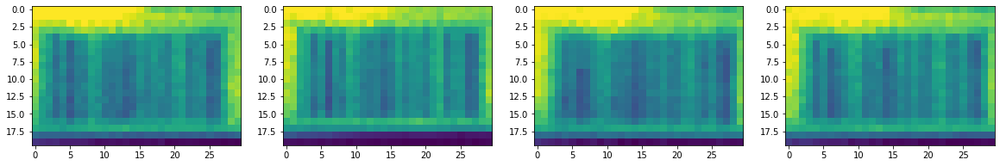

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[315:335,663:693])
plt.subplot(1,4,2)
plt.imshow(pip0[304:324,1913:1943])
plt.subplot(1,4,3)
plt.imshow(pip0[298:318,3161:3191])
plt.subplot(1,4,4)
plt.imshow(pip0[315:335,4405:4435])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr08_barcode/1500mm/lamp/frame-1.png')

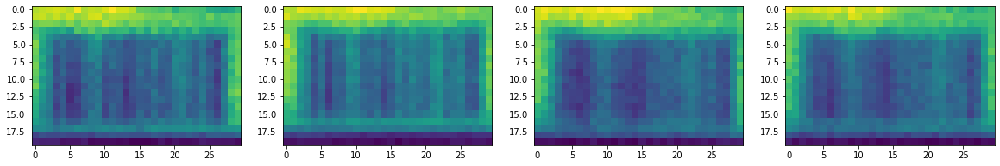

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[315:335,663:693])
plt.subplot(1,4,2)
plt.imshow(pip0[304:324,1913:1943])
plt.subplot(1,4,3)
plt.imshow(pip0[298:318,3161:3191])
plt.subplot(1,4,4)
plt.imshow(pip0[315:335,4405:4435])

## April 9 4 camera data

### 1 m

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/1000mm/red/frame-1.png')

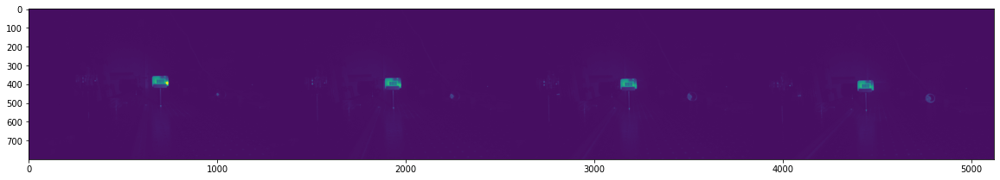

In [ ]:
plt.imshow(pip0)

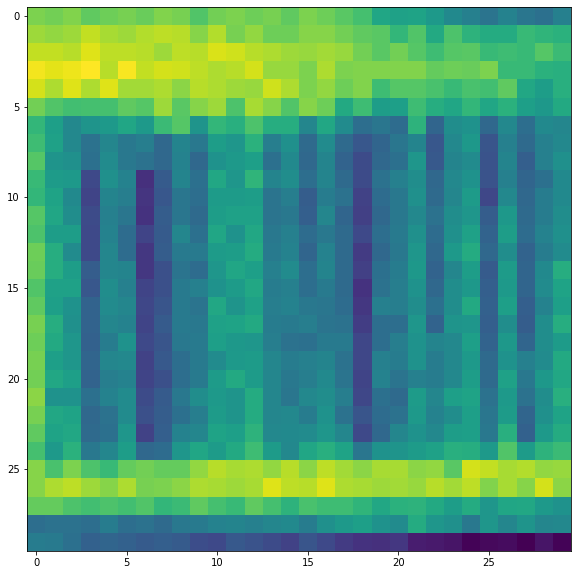

In [ ]:
plt.imshow(pip0[395:425,4419:4449])

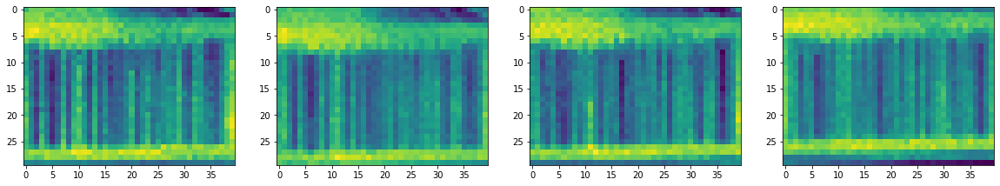

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[370:400,680:720])
plt.subplot(1,4,2)
plt.imshow(pip0[380:410,1913:1953])
plt.subplot(1,4,3)
plt.imshow(pip0[385:415,3163:3203])
plt.subplot(1,4,4)
plt.imshow(pip0[395:425,4419:4459])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/1000mm/red/frame-4.png')

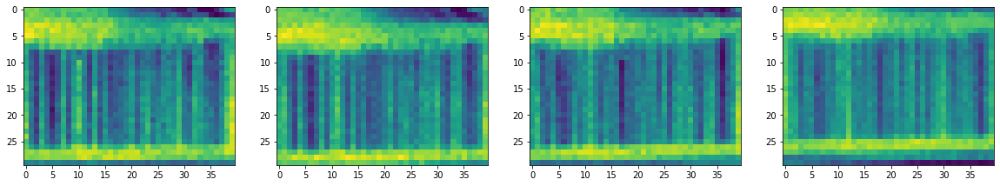

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[370:400,680:720])
plt.subplot(1,4,2)
plt.imshow(pip0[380:410,1913:1953])
plt.subplot(1,4,3)
plt.imshow(pip0[385:415,3163:3203])
plt.subplot(1,4,4)
plt.imshow(pip0[395:425,4419:4459])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/1000mm/violet/frame-1.png')

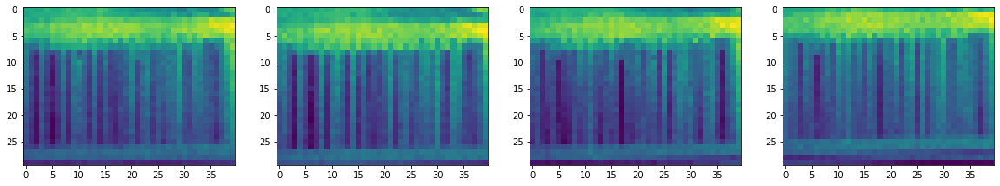

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[370:400,680:720])
plt.subplot(1,4,2)
plt.imshow(pip0[380:410,1913:1953])
plt.subplot(1,4,3)
plt.imshow(pip0[385:415,3163:3203])
plt.subplot(1,4,4)
plt.imshow(pip0[395:425,4419:4459])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/1000mm/white/frame-1.png')

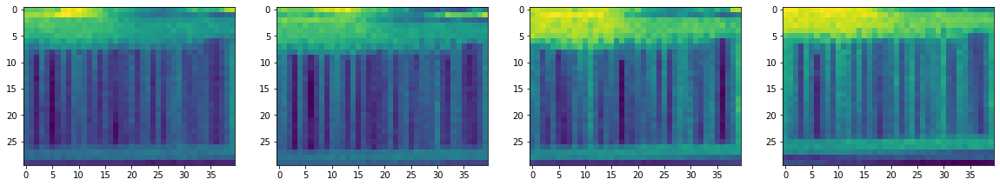

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[370:400,680:720])
plt.subplot(1,4,2)
plt.imshow(pip0[380:410,1913:1953])
plt.subplot(1,4,3)
plt.imshow(pip0[385:415,3163:3203])
plt.subplot(1,4,4)
plt.imshow(pip0[395:425,4419:4459])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/1000mm/lamp/frame-1.png')

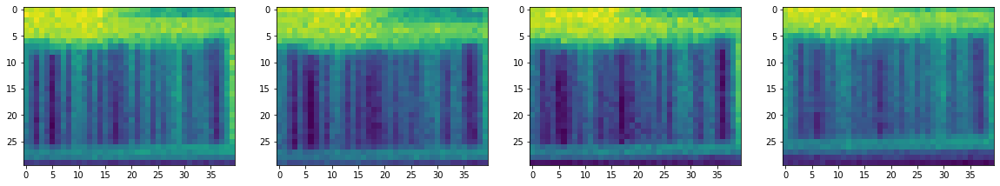

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[370:400,680:720])
plt.subplot(1,4,2)
plt.imshow(pip0[380:410,1913:1953])
plt.subplot(1,4,3)
plt.imshow(pip0[385:415,3163:3203])
plt.subplot(1,4,4)
plt.imshow(pip0[395:425,4419:4459])

### 2 m

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/red/frame-1.png')

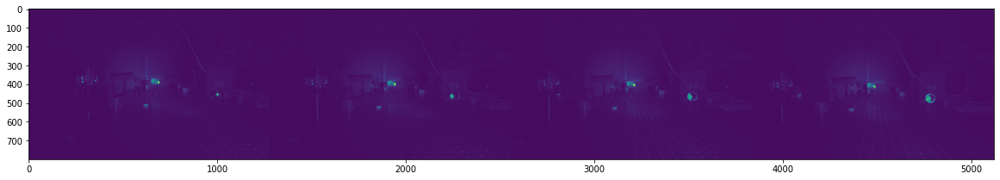

In [ ]:
plt.imshow(pip0)

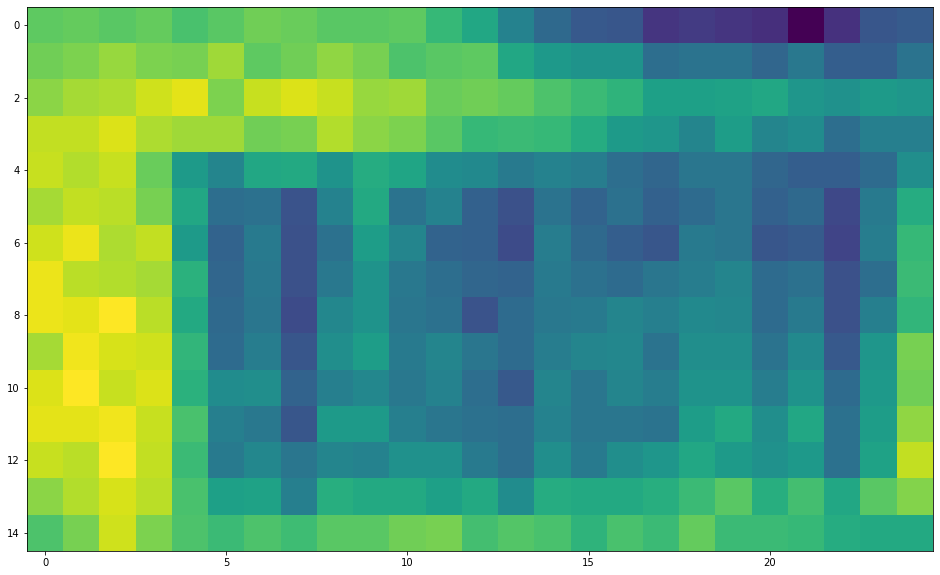

In [ ]:
plt.imshow(pip0[400:415,4455:4480])

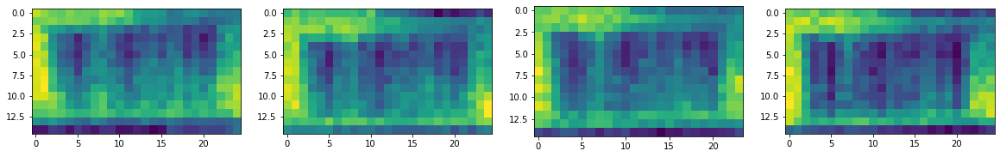

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[380:395,660:685])
plt.subplot(1,4,2)
plt.imshow(pip0[389:404,1913:1938])
plt.subplot(1,4,3)
plt.imshow(pip0[393:408,3183:3207])
plt.subplot(1,4,4)
plt.imshow(pip0[401:416,4457:4482])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/red/frame-3.png')

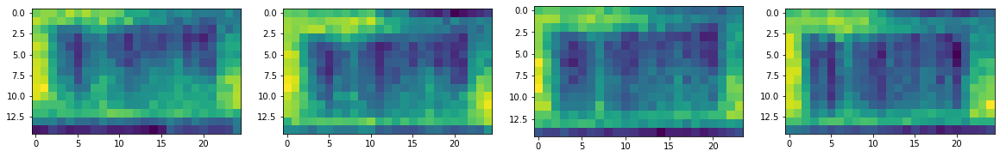

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[380:395,660:685])
plt.subplot(1,4,2)
plt.imshow(pip0[389:404,1913:1938])
plt.subplot(1,4,3)
plt.imshow(pip0[393:408,3183:3207])
plt.subplot(1,4,4)
plt.imshow(pip0[401:416,4457:4482])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/violet/frame-1.png')

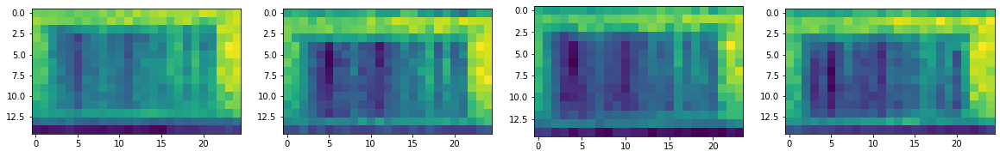

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[380:395,660:685])
plt.subplot(1,4,2)
plt.imshow(pip0[389:404,1913:1938])
plt.subplot(1,4,3)
plt.imshow(pip0[393:408,3183:3207])
plt.subplot(1,4,4)
plt.imshow(pip0[401:416,4457:4482])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/white/frame-1.png')

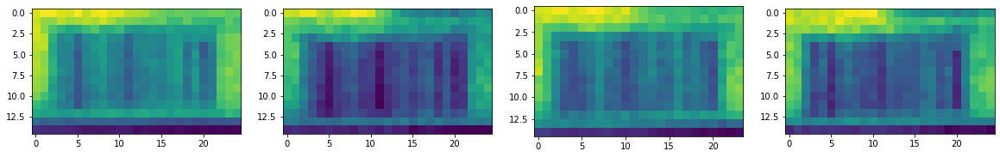

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[380:395,660:685])
plt.subplot(1,4,2)
plt.imshow(pip0[389:404,1913:1938])
plt.subplot(1,4,3)
plt.imshow(pip0[393:408,3183:3207])
plt.subplot(1,4,4)
plt.imshow(pip0[401:416,4457:4482])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/lamp/frame-1.png')

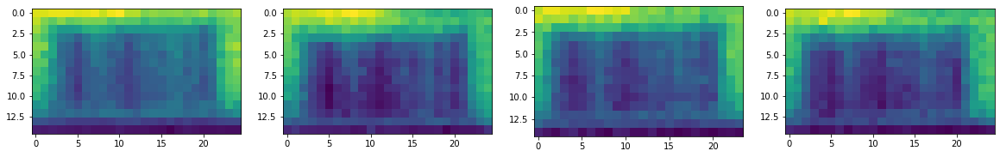

In [ ]:
plt.subplot(1,4,1)
plt.imshow(pip0[380:395,660:685])
plt.subplot(1,4,2)
plt.imshow(pip0[389:404,1913:1938])
plt.subplot(1,4,3)
plt.imshow(pip0[393:408,3183:3207])
plt.subplot(1,4,4)
plt.imshow(pip0[401:416,4457:4482])

### what about a different feature

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/red/frame-1.png')

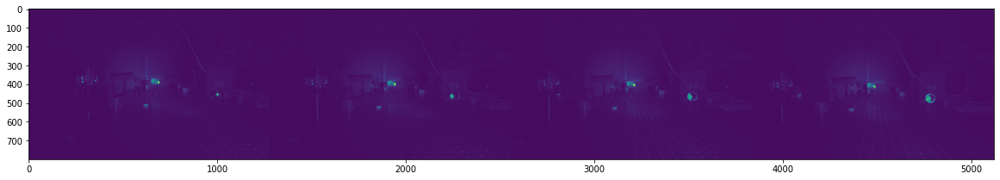

In [ ]:
plt.imshow(pip0)

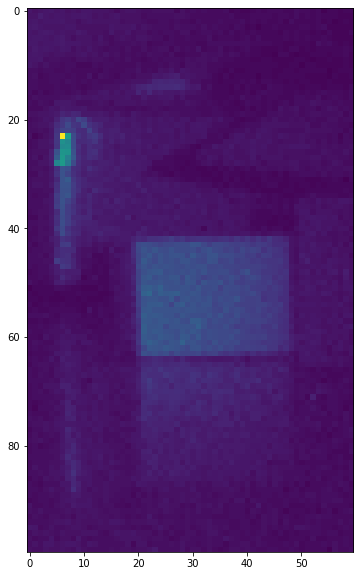

In [ ]:
plt.imshow(pip0[400:500,4600:4660])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/violet/frame-1.png')

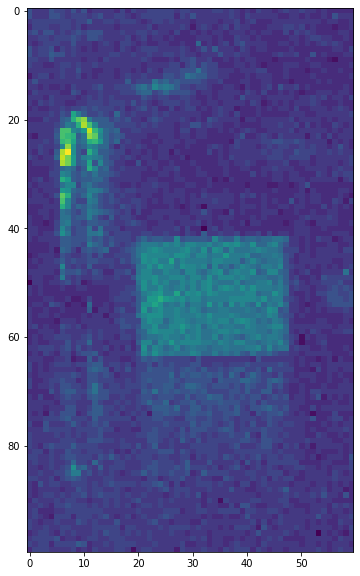

In [ ]:
plt.imshow(pip0[400:500,4600:4660])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/white/frame-1.png')

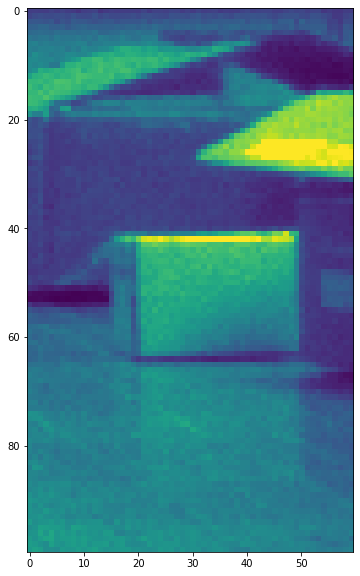

In [ ]:
plt.imshow(pip0[400:500,4600:4660])

In [ ]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/Apr09_barcode/2000mm/lamp/frame-1.png')

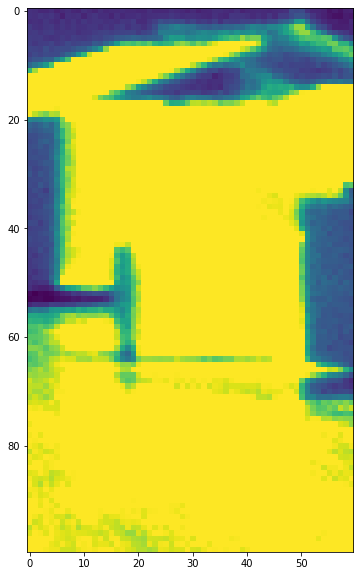

In [ ]:
plt.imshow(pip0[400:500,4600:4660])

## April 9 scan with blackfly camera, 8 mm lens, object at 1 meter step size 0.86 mm, which moves image by approximately 1 pixel.

### red led

In [3]:
! rm 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/red/red.mp4'
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/red/')

In [5]:
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/red/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/red/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1

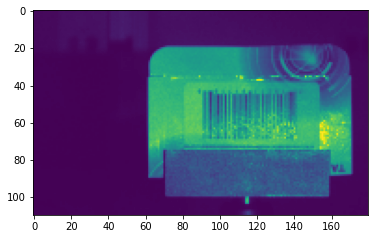

In [6]:
fig, ax = plt.subplots()
ims=[]
for i in range(len(imgFiles)):
    im = ax.imshow(pip[:,:,i], animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)

# To save the animation, use e.g.
#
# ani.save("movie.mp4")
#
# or
#
# writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
# ani.save("movie.mp4", writer=writer)

rc('animation', html='jshtml')
ani

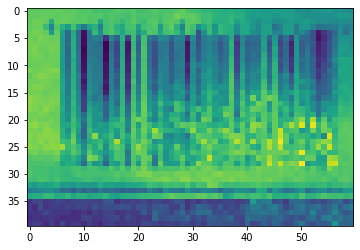

In [7]:
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)

fig, ax = plt.subplots()
ims=[]
for i in range(pop.shape[2]):
    im = ax.imshow(pop[40:80,(35+i):(95+i),i], animated=True)
    ims.append([im])
ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/red/red.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
ani.save(f, writer=writervideo)

rc('animation', html='jshtml')
ani



The total lens shift here is 51*0.8 mm =41.8 mm
wavelength 639 nm pixel size 6.9 microns. Modulation of a pixel by one period requires displacyment lambda F/p=.74 mm


In [ ]:
51*0.82

41.82

In [ ]:
.639*8/6.9

0.7408695652173913

### violet led

rm: cannot remove 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/violet.mp4': No such file or directory


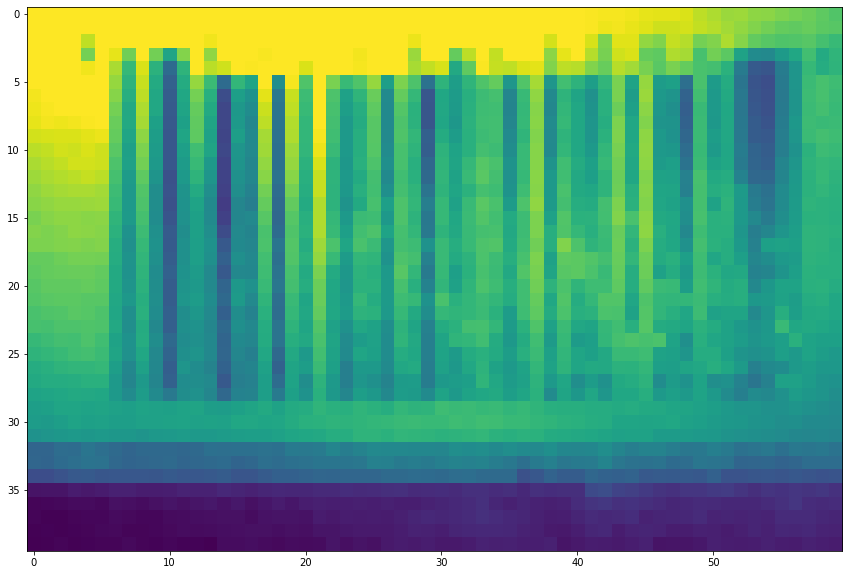

In [ ]:
! rm 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/violet.mp4'
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)

fig, ax = plt.subplots()
ims=[]
for i in range(pop.shape[2]):
    im = ax.imshow(pop[40:80,(35+i):(95+i),i], animated=True)
    ims.append([im])
ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/violet/violet.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
ani.save(f, writer=writervideo)

rc('animation', html='jshtml')
ani

### fluorescent lights

rm: cannot remove 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/white.mp4': No such file or directory


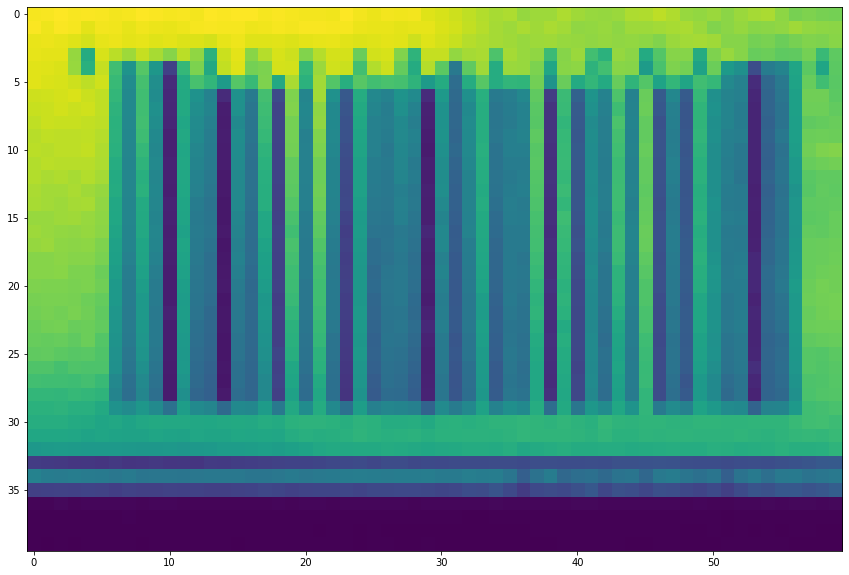

In [ ]:
! rm 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/white.mp4'
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)

fig, ax = plt.subplots()
ims=[]
for i in range(pop.shape[2]):
    im = ax.imshow(pop[40:80,(35+i):(95+i),i], animated=True)
    ims.append([im])
ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/white/white.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
ani.save(f, writer=writervideo)

rc('animation', html='jshtml')
ani

### incandescent lights

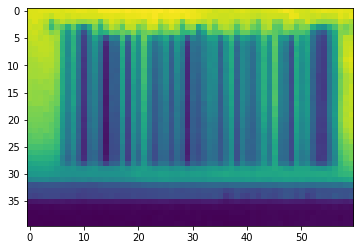

In [8]:
! rm 'gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/lamp/lamp.mp4'
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/lamp/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/lamp/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/lamp/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)

fig, ax = plt.subplots()
ims=[]
for i in range(pop.shape[2]):
    im = ax.imshow(pop[40:80,(35+i):(95+i),i], animated=True)
    ims.append([im])
ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/1000mm_0.86mm/lamp/lamp.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
ani.save(f, writer=writervideo)

rc('animation', html='jshtml')
ani

## April 9 scan with blackfly camera, 8 mm lens, object at 2 meter step size 1.72 mm 

### red

In [ ]:
dirB='gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/'
color='red'
os.remove(dirB+color+'/'+color+'.mp4') 
imgFiles=os.listdir(dirB+color+'/')
pip0=io.imread(dirB+color+'/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread(dirB+color+'/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1

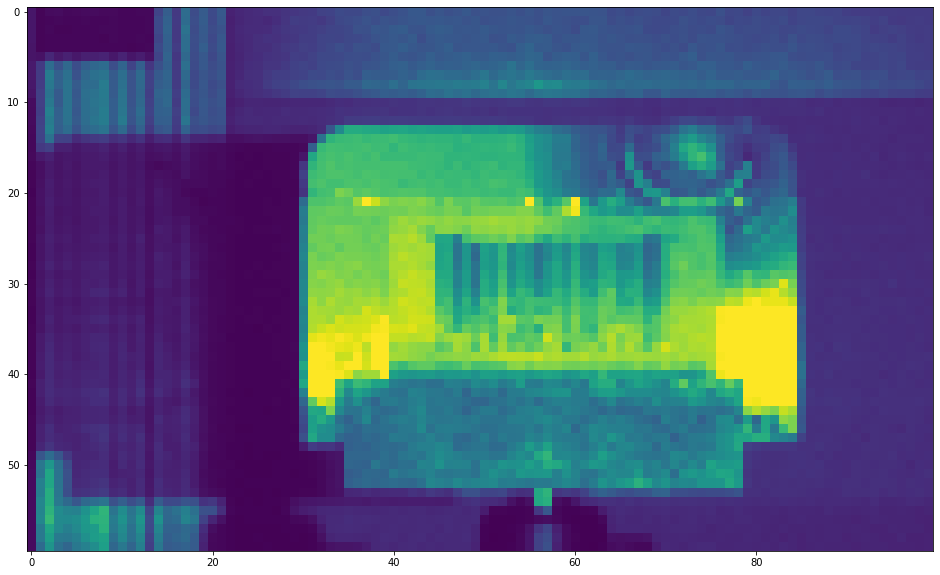

In [ ]:
fig, ax = plt.subplots()
ims=[]
for i in range(len(imgFiles)):
    im = ax.imshow(pip[:,:,i], animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)

# To save the animation, use e.g.
#
# ani.save("movie.mp4")
#
# or
#
# writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
# ani.save("movie.mp4", writer=writer)

rc('animation', html='jshtml')
ani

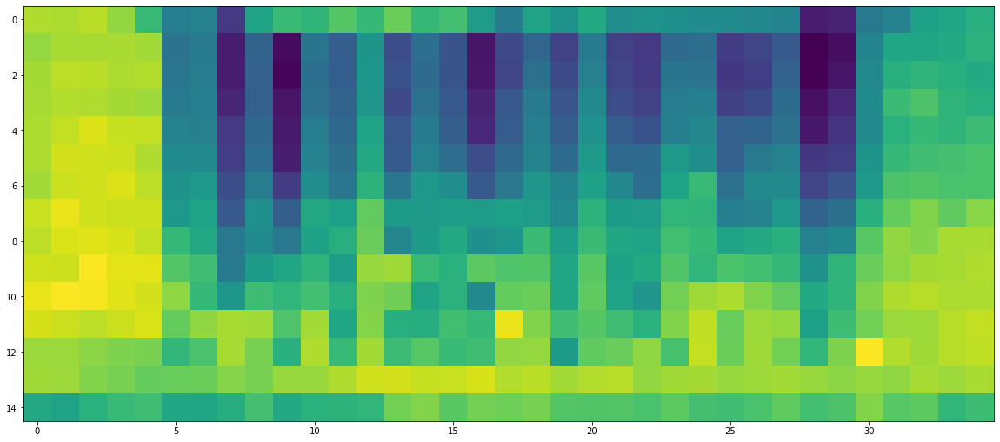

In [ ]:
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)
fig, ax = plt.subplots()
ims=[]
for i in range(np.int(len(imgFiles)/5)):
    im = ax.imshow(pop[25:40,np.int(15+i):np.int(50+i),i], animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = dirB+color+'/'+color+'.mp4'
writervideo = animation.FFMpegWriter(fps=3) 
ani.save(f, writer=writervideo)

rc('animation', html='jshtml')
ani

In [ ]:
plt.plot(np.arange(50),pop[30,0:50,0],np.arange(50),pop[30,0:50,25])

In [ ]:
pop.shape

In [ ]:
!ls

### violet

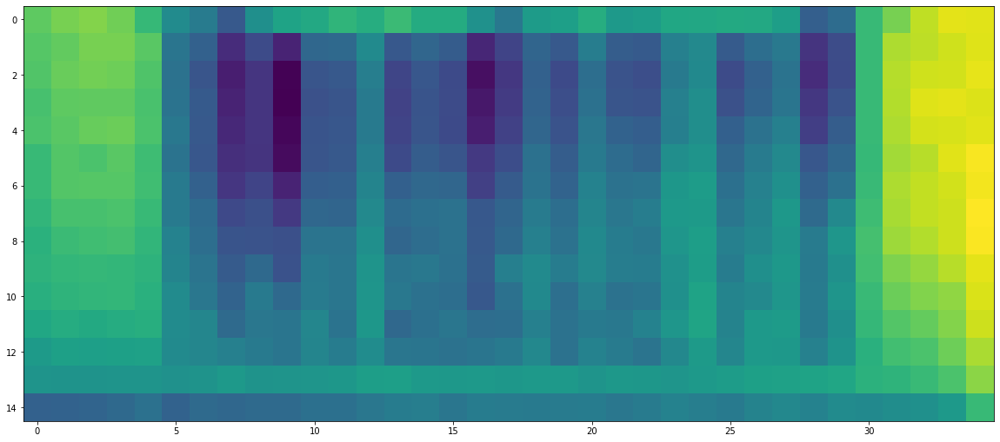

In [ ]:
!rm "gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/violet/violet.mp4" 
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/violet/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/violet/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/violet/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)
fig, ax = plt.subplots()
ims=[]
for i in range(np.int(len(imgFiles)/5)):
    im = ax.imshow(pop[25:40,np.int(15+i):np.int(50+i),i], animated=True)
    ims.append([im])

aniv = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/violet/violet.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
aniv.save(f, writer=writervideo)

rc('animation', html='jshtml')
aniv

### fluoresecent

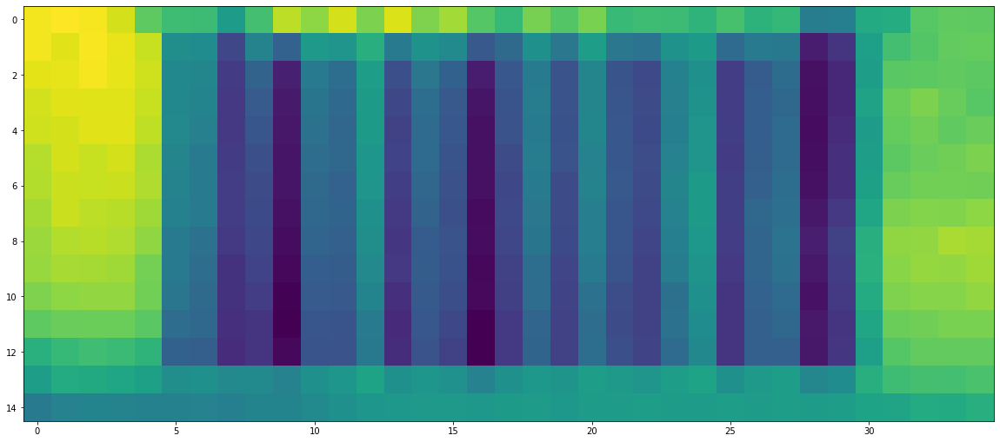

In [ ]:
!rm "gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/white/white.mp4" 
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/white/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/white/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/white/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)
fig, ax = plt.subplots()
ims=[]
for i in range(np.int(len(imgFiles)/5)):
    im = ax.imshow(pop[25:40,np.int(15+i):np.int(50+i),i], animated=True)
    ims.append([im])

aniw = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/white/white.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
aniw.save(f, writer=writervideo)

rc('animation', html='jshtml')
aniw

### incandescent

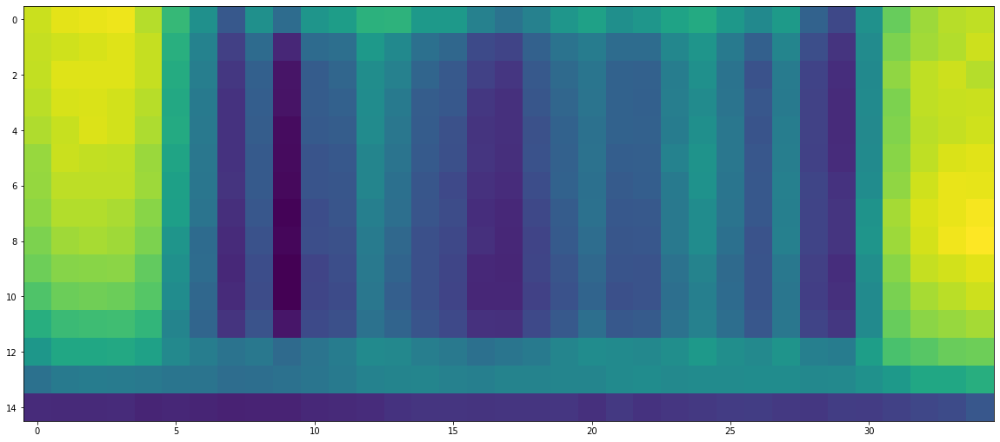

In [ ]:
!rm "gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/lamp/lamp.mp4" 
imgFiles=os.listdir('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/lamp/')
pip0=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/lamp/'+imgFiles[0])
pip0=np.sum(pip0,axis=2)
pip0.shape
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread('gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/lamp/'+imgF)
  pippy=np.sum(pippy,axis=2)
  pip[:,:,ct]=pippy
  ct=ct+1
# now lets try averaging the frames at a given position (5 frames each) and moving the display window to track the scene.
pop=np.zeros((pip0.shape[0],pip0.shape[1],np.int(len(imgFiles)/5))) 
for ct in range(np.int(len(imgFiles)/5)):
  pop[:,:,ct]=np.sum(pip[:,:,5*ct:(5*ct+5)],axis=2)
fig, ax = plt.subplots()
ims=[]
for i in range(np.int(len(imgFiles)/5)):
    im = ax.imshow(pop[25:40,np.int(15+i):np.int(50+i),i], animated=True)
    ims.append([im])

anil = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)
f = r"gdrive/MyDrive/Research/arrayCameraPtychography/testData/apr9scan/2000mm_1.72mm/lamp/lamp.mp4" 
writervideo = animation.FFMpegWriter(fps=3) 
anil.save(f, writer=writervideo)

rc('animation', html='jshtml')
anil

# May 24 scan with 4 camera array

In [38]:
dirB='gdrive/MyDrive/Research/arrayCameraPtychography/testData/4cameraRedLEDdiffuse'
color='red'
imgFiles=os.listdir(dirB+'/')
pip0=io.imread(dirB+'/'+imgFiles[0])
#pip0=np.sum(pip0,axis=2)
pip0.shape
#pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
#ct=0
#for imgF in imgFiles:
#  pippy=io.imread(dirB+color+'/'+imgF)
#  pippy=np.sum(pippy,axis=2)
#  pip[:,:,ct]=pippy
#  ct=ct+1


(800, 5120)

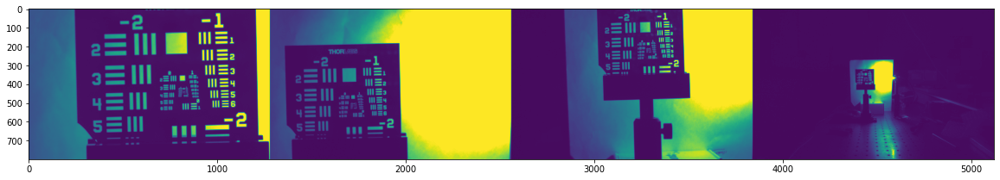

In [12]:
plt.imshow(pip0)

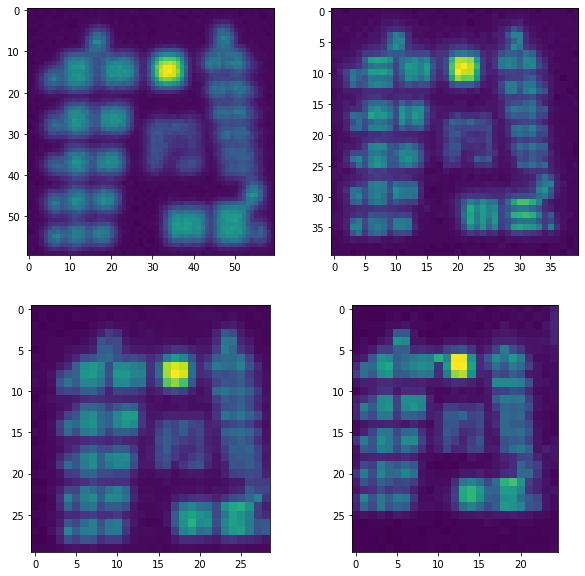

In [37]:
plt.subplot(2,2,1)
plt.imshow(pip0[410:470,790:850])
plt.subplot(2,2,2)
plt.imshow(pip0[495:535,1705:1745])
plt.subplot(2,2,3)
plt.imshow(pip0[205:235,3273:3302])
plt.subplot(2,2,4)
plt.imshow(pip0[360:390,4430:4455])
plt.rcParams['figure.figsize'] = [10, 10]
plt.show()

In [41]:
pip=np.zeros((pip0.shape[0],pip0.shape[1],len(imgFiles)))
ct=0
for imgF in imgFiles:
  pippy=io.imread(dirB+'/'+imgF)
  pip[:,:,ct]=pippy
  ct=ct+1


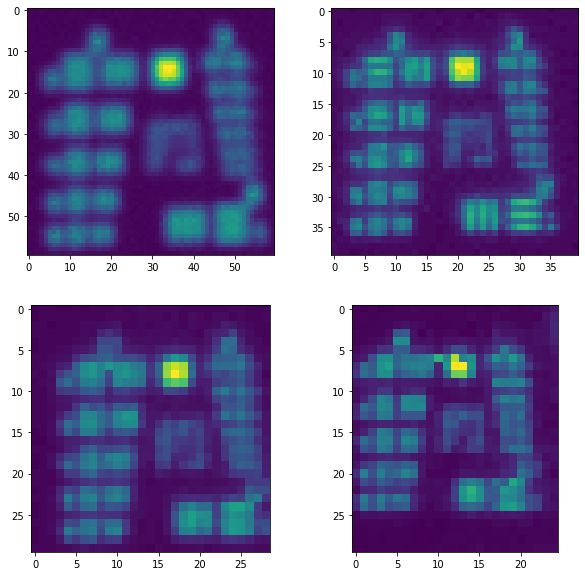

In [45]:
ct=5
plt.subplot(2,2,1)
plt.imshow(pip[410:470,790:850,ct])
plt.subplot(2,2,2)
plt.imshow(pip[495:535,1705:1745,ct])
plt.subplot(2,2,3)
plt.imshow(pip[205:235,3273:3302,ct])
plt.subplot(2,2,4)
plt.imshow(pip[360:390,4430:4455,ct])
plt.rcParams['figure.figsize'] = [10, 10]
plt.show()